In [1]:
%matplotlib inline
%config InlineBackend.print_figure_kwargs={'facecolor' : "white"}

import copy
import geojson
import io
import json
import math
import os
import pandas as pd
import numpy as np
import plotly
import plotly.offline as offline
import plotly.express as px
import plotly.graph_objects as go
import plotly.figure_factory as ff
import random
import seaborn as sns
import statsmodels.api as sm
import statsmodels.formula.api as smf
import matplotlib.pyplot as plt
import matplotlib.ticker as mtick
import matplotlib
import matplotlib.dates as mdates

from datetime import datetime, timedelta
from IPython.display import Markdown, display, Image
from matplotlib.dates import MO, TU, WE, TH, FR, SA, SU
from PIL import Image as PILImage
from scipy.stats.stats import pearsonr
from urllib.request import urlopen

def printmd(string):
    display(Markdown(string))

local_covid_19_data = '/Users/davidmorton/Documents/COVID-19/'
local_directory = os.getcwd()

field_test_availability = 'Tests Per 100,000 People'
field_rolling_average = '7-Day Confirmed Rolling Average'

!git -C $local_covid_19_data pull

rawdata = pd.read_csv('https://data.cdc.gov/api/views/u6jv-9ijr/rows.csv?accessType=DOWNLOAD&bom=true&format=true%20target=')
rawdata = rawdata[rawdata['Jurisdiction'] != 'United States']

us_state_abbrev = {
    'Alabama': 'AL',
    'Alaska': 'AK',
    'American Samoa': 'AS',
    'Arizona': 'AZ',
    'Arkansas': 'AR',
    'California': 'CA',
    'Colorado': 'CO',
    'Connecticut': 'CT',
    'Delaware': 'DE',
    'District of Columbia': 'DC',
    'Florida': 'FL',
    'Georgia': 'GA',
    'Guam': 'GU',
    'Hawaii': 'HI',
    'Idaho': 'ID',
    'Illinois': 'IL',
    'Indiana': 'IN',
    'Iowa': 'IA',
    'Kansas': 'KS',
    'Kentucky': 'KY',
    'Louisiana': 'LA',
    'Maine': 'ME',
    'Maryland': 'MD',
    'Massachusetts': 'MA',
    'Michigan': 'MI',
    'Minnesota': 'MN',
    'Mississippi': 'MS',
    'Missouri': 'MO',
    'Montana': 'MT',
    'Nebraska': 'NE',
    'Nevada': 'NV',
    'New Hampshire': 'NH',
    'New Jersey': 'NJ',
    'New Mexico': 'NM',
    'New York': 'NY',
    'North Carolina': 'NC',
    'North Dakota': 'ND',
    'Northern Mariana Islands':'MP',
    'Ohio': 'OH',
    'Oklahoma': 'OK',
    'Oregon': 'OR',
    'Pennsylvania': 'PA',
    'Puerto Rico': 'PR',
    'Rhode Island': 'RI',
    'South Carolina': 'SC',
    'South Dakota': 'SD',
    'Tennessee': 'TN',
    'Texas': 'TX',
    'Utah': 'UT',
    'Vermont': 'VT',
    'Virgin Islands': 'VI',
    'Virginia': 'VA',
    'Washington': 'WA',
    'West Virginia': 'WV',
    'Wisconsin': 'WI',
    'Wyoming': 'WY'
}

states_to_drop = ['Puerto Rico', 'American Samoa', 'Guam', 'District of Columbia', 'Northern Mariana Islands', 'Virgin Islands']


Already up to date.


In [2]:
def get_single_date_data(date):
    datestr = date.strftime('%m-%d-%Y')
    filename = local_covid_19_data + 'csse_covid_19_data/csse_covid_19_daily_reports_us/' + datestr + '.csv'
    result = pd.read_csv(filename)
    result['Date'] = date
    return result

def get_daily_report_data():
    start_date_for_daily_data = datetime(2020, 4, 12)
    current_date = start_date_for_daily_data

    yesterday = (datetime.now() + timedelta(days = -1))
    #yesterday = datetime.now()
    lastdate = yesterday.strftime('%m-%d-%Y')
    
    series = pd.DataFrame()

    while True:
        series = series.append(get_single_date_data(current_date))
        current_date = current_date + timedelta(days = 1)
        if current_date > yesterday:
            break
    
    
    return series

def smooth_bad_cumulative_values(series, columns):
    
    for columnname in columns:
        states = np.sort(series['Province_State'].unique())

        for state in states:
            stateseries = series[series['Province_State'] == state]

            cumulative = stateseries[columnname].cummax()

            series.loc[(series['Province_State'] == state) & (stateseries[columnname] < cumulative), columnname] = np.nan

            interpolation = series[series['Province_State'] == state][columnname].interpolate()

            series.loc[series['Province_State'] == state, columnname] = interpolation

    return series;

def drop_instances_where_reported_equals_confirmed(series):
    series.loc[series['NewConfirmedVsTests'] > 0.5] = np.nan 
    return series

def clean_daily_report_data(series, rollingrate):
    series.reset_index(inplace=True)
    series = series.dropna(subset=['People_Tested', 'Confirmed']).copy()
    
    series = smooth_bad_cumulative_values(series, ['People_Tested', 'Confirmed'])
    
    series = series.set_index(['Province_State', 'Date'])
    
    series['NewConfirmed'] = series.sort_values(by=['Date']).groupby(['Province_State'])['Confirmed'].transform(pd.Series.diff).fillna(0)
    series['NewTests'] = series.sort_values(by=['Date']).groupby(['Province_State'])['People_Tested'].transform(pd.Series.diff).fillna(0)
    series['NewConfirmedVsTests'] = series['NewConfirmed'].div(series['NewTests']).dropna()
    series[field_rolling_average] = pd.DataFrame(series.groupby('Province_State', as_index=False)['NewConfirmed'].rolling(rollingrate).sum()).reset_index().set_index(['Province_State', 'Date'])['NewConfirmed'].div(pd.DataFrame(series.groupby('Province_State', as_index=False)['NewTests'].rolling(rollingrate).sum()).reset_index().set_index(['Province_State', 'Date'])['NewTests'])
    series[field_test_availability] = pd.DataFrame(series.groupby('Province_State', as_index=False)['Testing_Rate'].rolling(rollingrate).mean()).reset_index().set_index(['Province_State', 'Date'])['Testing_Rate']
    series['RollingStd'] = pd.DataFrame(series.groupby('Province_State', as_index=False)['NewConfirmedVsTests'].rolling(rollingrate).std()).reset_index().set_index(['Province_State', 'Date'])['NewConfirmedVsTests']
    series['RollingCV'] = series['RollingStd'].div(series[field_rolling_average])
    
    series = series.replace([np.inf, -np.inf], np.nan).dropna(subset=['NewConfirmedVsTests'])
    
    series = series.reset_index()
     
    return series;

def get_timeseries(rollingrate, states_to_drop):
    original_series = get_daily_report_data();    
    series = original_series.copy()
    series = clean_daily_report_data(series, rollingrate)
    series = series[~series["Province_State"].isin(states_to_drop)]
    return series

def output_rolling_confirmed_chart(state, ax):
    
    statedata = series[series['Province_State'] == state].copy().dropna(subset=[field_rolling_average, 'Date'])
    latestdate = statedata['Date'].max()
    earliestdate = statedata['Date'].min()
    
    maxvalue = statedata[field_rolling_average].max() + 0.01
    
    color = "Blue"
    yes = (datetime.now() + timedelta(days = -1)).date()
    if (latestdate < yes):
        color = "Gray"
        
    months = mdates.MonthLocator()
    sundays = mdates.WeekdayLocator(byweekday=SU)
        
    ax = statedata.plot.line(
        x='Date', 
        y=field_rolling_average, 
        xlim=(earliestdate, latestdate), 
        ylim=(0, maxvalue), 
        ax=ax, 
        legend=False, 
        color=color
    )
    
    
    
    ax = statedata.plot.scatter(
        x='Date', 
        y='NewConfirmedVsTests', 
        ax=ax, 
        legend=False, 
        color="Red"
    )
    
    ax.set_ylabel('Percentage Confirmed (7-Day Rolling Avg)', fontsize=12)
    
    ax.yaxis.set_major_formatter(mtick.PercentFormatter(1.0, decimals=0))
    ax.xaxis.set_major_locator(sundays)
    month_formatter = mdates.DateFormatter("%b %d")
    ax.set_xlabel("")
    ax.xaxis.set_major_formatter(month_formatter)
    ax.minorticks_off()
    for tick in ax.get_xticklabels():
        tick.set_rotation(45)
    
    ax.yaxis.grid()
    
    years = mdates.YearLocator()   # every year
    months = mdates.MonthLocator()  # every month
    day_formatter = mdates.DateFormatter('%d')
    days = mdates.DayLocator()
    
    #ax.xaxis.set_major_locator(months)
    #ax.xaxis.set_minor_formatter(day_formatter)
    #ax.xaxis.set_major_formatter(mtick.FuncFormatter(format_date))
    #ax.format_xdata = lambda x: 'BLAH' #('A%d' % x) if x.weekday() == 6 else '';


    ax.set_title(state + ' ' + "{0:.2%} (upd {1:%b %d})".format(statedata[-1:][field_rolling_average].iloc[0], latestdate))

def output_multiple_states(states):
    states.sort()
    numrows = math.ceil(len(states) / 3)
    fig, axes = get_axes(numrows, 3);

    for i, state in enumerate(states):
        output_rolling_confirmed_chart(state, axes[i])
        
def format_date(x, pos=None):
    thisind = np.clip(int(x + 0.5), 0, N - 1)
    return date[thisind].strftime('%Y-%m-%d')


def get_axes(rows, cols):
    fig, axes = plt.subplots(rows, 
                         cols, 
                         figsize=(18, rows*6), 
                         gridspec_kw={'hspace': 0.5, 'wspace': 0.3}, 
                         facecolor='#fbfbfb')
    if (rows * cols) > 1:
        return fig, axes.flatten()
    else:
        return fig, [axes]

def get_latest_data():
    yesterdaydata = series.merge(series.groupby('Province_State')['Date'].max().reset_index(), on=["Province_State", "Date"])

    yesterdaydata.index = yesterdaydata['Province_State']
    raw_state_abbreviations = pd.read_csv(local_directory + '/states.csv')
    raw_state_abbreviations.index = raw_state_abbreviations['State']

    yesterdaydata['StateId'] = raw_state_abbreviations['Abbreviation']

    yesterdaydata = yesterdaydata.dropna(subset=['StateId'], axis=0)
 
    yesterdaydata = yesterdaydata[yesterdaydata[field_rolling_average] < 0.5]
    return yesterdaydata


def make_usa_choropleth(series, locations, title, colorbartitle, colorspectrum):
    
    bins = pd.qcut(series, q=8, retbins=True)[1]
    bins = (bins - bins.min()) / (bins.max() - bins.min())

    colorscale = list(zip(bins, colorspectrum))

    fig = go.Figure(
        data=go.Choropleth(
            locations=locations,
            z = series,
            locationmode = 'USA-states',
            colorscale = colorscale,
            colorbar_title = colorbartitle
        )
    )

    fig.update_layout(
        title_text = title,
        geo_scope='usa', # limite map scope to USA
    )

    fig.show()
    
def plot_bar(series, x, y, **kwargs):
    interested_state = kwargs.get('interested_state', None)
    data = series.copy().sort_values(by=y).reset_index(drop=True)
    ax = data.plot.bar(x = x, y=y, figsize=(15,8))
    ax.yaxis.grid()
    if interested_state != None:
        ax.get_children()[data[data["StateId"] == interested_state].index[0]].set_color('r')
    plt.show(ax)

def county_choropleth(selected_state, drop_states, normalize_colorscale, colorscale_to_use):
    yesterday = (datetime.now() + timedelta(days = -1))
    lastdate = yesterday.strftime('%m-%d-%Y')
    fipsData = pd.read_csv(local_covid_19_data + 'csse_covid_19_data/UID_ISO_FIPS_LookUp_Table.csv')
    filename = local_covid_19_data + 'csse_covid_19_data/csse_covid_19_daily_reports/' + lastdate + '.csv'
    result = pd.read_csv(filename)

    result = result.dropna(subset=['FIPS', 'Active']).set_index("FIPS")

    result = fipsData.merge(result, on="FIPS", how="left").dropna(subset=["FIPS", "Lat_x", "Long__x", "Admin2_x"]);

    result = result.reset_index()[["FIPS", "Population", "Active", "Province_State_x", "Admin2_x"]]
    result = result.rename(columns={"Province_State_x": "Province_State", "Admin2_x": "Admin2"})
    result = result.fillna(value={"Active": 10**-10});

    result = result[~result['Province_State'].isin(drop_states)]

    map_data = result

    badfips = [80008, 80013, 80015, 80017, 80026, 80040, 80047, 90049, 90001, 90002, 90004, 90005, 90006, 90008, 90009, 90010, 90012, 90013, 90015, 90016, 90017, 90018, 90019, 90020, 90021, 90022, 90023, 90024, 90025, 90026, 90027, 90028, 90029, 90030, 90031, 90032, 90033, 90034, 90035, 90036, 90037, 90038, 90039, 90040, 90041, 90042, 90044, 90045, 90046, 90047, 90048, 90049, 90050, 90051, 90053, 90054, 90055, 90056, 88888, 99999, 66, 69, 72, 78]

    if (selected_state != None):
        map_data = map_data[map_data["Province_State"].isin(selected_state)]

    map_data = map_data[~map_data['FIPS'].isin(badfips)]

    map_data["ActiveByPopulation"] = map_data["Active"].div(map_data["Population"])

    with open(local_directory + '/geojson-counties-fips.json') as response:
        allcounties = json.load(response)

    if (selected_state != None):
        fips_for_state = fipsData[(fipsData["Province_State"].isin(selected_state)) & (fipsData["Admin2"].isna())]['FIPS'].astype(int).astype(str).str.pad(2, side="left", fillchar='0').tolist()

        counties = copy.deepcopy(allcounties)

        counties["features"] = []

        non_contained = []
        for feature in allcounties["features"]:
            if (str(feature["properties"]["STATE"]) in fips_for_state):
                feature["properties"]["FIPS"] = str(int(feature["properties"]["STATE"])) + feature["properties"]["COUNTY"]
                counties["features"].append(feature);
        
    else:
        counties = allcounties
        for feature in counties["features"]:
            feature["properties"]["FIPS"] = str(int(feature["properties"]["STATE"])) + feature["properties"]["COUNTY"]

    map_data['text'] = map(', '.join, zip(map_data["Admin2"], map_data["ActiveByPopulation"]))
    map_data['ActiveByPopulationPct'] = np.around(map_data["ActiveByPopulation"] * 100, decimals=2)
    map_data["Admin2"] = map_data["Admin2"] + ', ' + map_data["Province_State"]

    if (normalize_colorscale == True):
        bins = pd.qcut(map_data['ActiveByPopulationPct'], q=8, retbins=True)[1]
        colorstops = (bins - bins.min()) / (bins.max() - bins.min())
        colorscale = list(zip(colorstops, getattr(px.colors.sequential, colorscale_to_use)))
    else:
        colorscale = colorscale_to_use

    fig = px.choropleth(map_data, geojson=counties, locations='FIPS', color='ActiveByPopulationPct',
                               #color_continuous_scale="Blues",
                                color_continuous_scale=colorscale,
                                featureidkey='properties.FIPS',
                                hover_data=["ActiveByPopulationPct", "Population", "Province_State"],
                                hover_name="Admin2",
                                #opacity=0.3,
                                
                                #mapbox_style="carto-darkmatter",
                                labels={"ActiveByPopulationPct": "Percent Active"}
                              )

    fig.update_geos(showcountries=False, showcoastlines=False, showland=False, fitbounds='locations')
    fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
    fig.show()


def output_state_data(state):

    if (type(state) == str):
        state = [state]
        
    if (state != None):
        output_multiple_states(state)
        plt.show()

    county_choropleth(
        selected_state = state,
        drop_states = ['Alaska', 'Hawaii'],
        normalize_colorscale = True,
        colorscale_to_use = "Reds"
    )
    
def get_pivottable():
    gte2020 = rawdata[rawdata['Year'] == 2020].groupby(['Jurisdiction', 'Week'])[['Number of Deaths']].sum()
    maxweek = gte2020.reset_index()['Week'].max()
    lt2020 = rawdata[(rawdata['Year'] < 2020) & (rawdata['Week'] <= maxweek)].groupby(['Jurisdiction', 'Year', 'Week']).sum()[['Number of Deaths']].groupby(['Jurisdiction', 'Week']).mean()#.rename(columns={'Number of Deaths': 'Avg'})

    compareData = lt2020.copy().rename(columns={'Number of Deaths':'Average'})

    compareData['2020'] = gte2020['Number of Deaths']

    compareData = compareData.fillna(0)

    compareData['Difference'] = (compareData['2020'].div(compareData['Average']) * 100) - 100

    compareData = compareData.reset_index()

    pivottable = compareData.pivot(index='Week', columns='Jurisdiction', values='Difference')

    pivottable['Week Ending'] = pd.to_datetime(rawdata[rawdata['Year'] == 2020].groupby(['Week'])['Week Ending Date'].max())
    pivottable = pivottable.reset_index().set_index('Week Ending').drop(['Week'], axis=1)
    pivottable['New York'] = pivottable['New York'] + pivottable['New York City']
    pivottable = pivottable.drop(['New York City', 'Puerto Rico'], axis=1)
    return pivottable

def get_normalized_excess_deaths():
    pivottable = get_pivottable()
    states = pivottable.columns

    fig, ax = plt.subplots(figsize=(15,20))  

    pvt2 = pivottable.copy()

    df_norm_col=(pvt2-pvt2.mean())/pvt2.std()
    
    df_norm_col_2 = df_norm_col.rolling(window=3).mean().dropna()
    df_norm_col_2 = df_norm_col.reindex(df_norm_col.idxmax().sort_values().index, axis=1)

    sns.heatmap(df_norm_col_2.transpose(), xticklabels=True, yticklabels=True, ax=ax, cbar=False, linewidths=2, linecolor='white', cmap="Reds")
    x_dates = df_norm_col_2.index.strftime('%Y-%m-%d').sort_values().unique()

    ax.set_xticklabels(labels=x_dates, rotation=45, ha='right')
    ax.set_ylabel('')
    ax.set_xlabel('')
    ax.set_title('Normalized Excess Deaths, 2020 vs 2015-2019', size=30, pad=20)

    plt.annotate('Reported deaths per week in 2020 vs the same time period\'s average in 2015-2019, and sorted by peak. Source: CDC', (0,0), (100, -70), xycoords='axes fraction', textcoords='offset points', va='top')

    plt.savefig("covid19-heatmap.png")

def get_gif_map():
    pivottable = get_pivottable()
    pivottable2 = pivottable.copy()

    pivottable2 = pivottable2.rename(columns=us_state_abbrev)
    
    pivottable2 = pivottable2.rolling(window=3).mean().dropna()

    sortedvalues = np.sort(pivottable2.values.flatten().flatten())
    mx = max(sortedvalues)
    rg = max(sortedvalues) - min(sortedvalues)
    mn = min(sortedvalues)
    pivottable3 = (pivottable2 - mn).div(rg)
    pivottable3 = pivottable3.resample(rule='8H').asfreq().interpolate()

    bins = pd.qcut(sortedvalues, q=8, retbins=True)[1]
    bins = (bins - bins.min()) / (bins.max() - bins.min())

    colorscale = list(zip(bins, getattr(px.colors.sequential, 'Reds')))

    images = []

    for i in np.arange(0, pivottable3.shape[0]):

        data = pivottable3.iloc[i]
        fig = go.Figure(
            data=go.Choropleth(
                locations=data.index,
                z = data,
                locationmode = 'USA-states',
                colorscale = colorscale,
                showscale=False,
                zmin=0,
                zmax=1
            )
        )


        fig.update_layout(
            title= {
                "text":'Daily Excess Deaths ' + data.name.strftime('%-m-%-d-%Y'),
                'xanchor': 'center',
                'x':0.5
            },
            font=dict(
                size=18
            ),
            geo_scope='usa', # limite map scope to USA
            annotations=[
               go.layout.Annotation(
                    showarrow=False,
                    text='Source: CDC Excess Deaths (https://www.cdc.gov/nchs/nvss/vsrr/covid19/excess_deaths.htm)',
                    xanchor='center',
                    x=.5,
                    yanchor='bottom',
                    y=-0.2,
                    font=dict(
                        size=12
                    )
            ),
            go.layout.Annotation(
                    showarrow=False,
                    text='Darker colors indicate a higher death rate for 2020 when compared to the same time period in 2015-2019',
                    xanchor='center',
                    x=0.5,
                    yanchor='bottom',
                    y=-0.15,
                    font=dict(
                        size=12
                    ))]
        )


        img_bytes = fig.to_image(format='png')
        image = PILImage.open(io.BytesIO(img_bytes))
        #image.save("gifdata/"+str(data.name).replace(':', '-')+".png")

        images.append(image)
        if i == pivottable3.shape[0] - 1:
            for i in np.arange(0,40):
                images.append(image)

    url = 'covid19-case.gif'
    images[0].save(url,
                   save_all=True, append_images=images[1:], optimize=True, duration=75, loop=0)
    return url + "?c=" + str(random.randint(0,2e9))

def get_rolling_heatmap():
    xx = get_daily_report_data().sort_values(by=['Province_State', 'Date']).reset_index()
    xx['People_Tested_2'] = xx.sort_values(by=['Date']).groupby(['Province_State'])['People_Tested'].cummax()
    xx['New_Tests'] = xx.sort_values(by=['Province_State', 'Date']).groupby(['Province_State'])['People_Tested'].diff()
    xx = xx[['Province_State', 'Date', 'Confirmed', 'People_Tested', 'New_Tests', 'People_Tested_2']]
    xx['Confirmed_Percent'] = xx['Confirmed'].div(xx['New_Tests']) * 100
    pd.set_option('display.max_rows', 500)
    xx['ConfirmedPercent'] = xx['Confirmed'].div(xx['People_Tested'])
    xx = xx[~xx['Province_State'].isin(['Puerto Rico', 'Recovered', 'Diamond Princess', 'American Samoa', 'Grand Princess', 'New Jersey', 'Northern Mariana Islands'])]
    xx = xx.set_index(['Province_State', 'Date'])
    xx['ConfirmedPercentRolling'] = xx.sort_values(by=['Province_State', 'Date']).groupby('Province_State')['ConfirmedPercent'].rolling(window=7).mean().reset_index(level=1, drop=1)

    xx = xx.dropna()
    xxp = xx.reset_index()[['Province_State', 'Date', 'ConfirmedPercentRolling']].pivot(values='ConfirmedPercentRolling', index='Date', columns='Province_State')
    xxp = xxp.reindex(xxp.mean().sort_values(ascending=False).index, axis=1)

    #plt.style.use('dark_background')
    plt.subplots(figsize=(18,23))
    ax = sns.heatmap(xxp.transpose() * 100, vmin=0, vmax=20, cmap='icefire')

    x_dates = xxp.index.strftime('%Y-%m-%d').sort_values().unique()
    x_dates = [list(reversed(pd.Series(xxp.index)))[i].strftime('%Y-%m-%d') if i % 7==0 else '' for i in np.arange(len(xxpindex)-1,-1, -1)]

    ylabels = ['{0} ({1:.2f}%)'.format(a[0], a[1]*100) for a in zip(xxp.columns, xxp.mean().sort_values(ascending=False))]
    ax.set_xticklabels(labels=x_dates, rotation=45, ha='right')
    ax.set_yticklabels(labels=ylabels)
    ax.set_ylabel('')
    ax.set_xlabel('')
    ax.set_title('7-Day Rolling Average of Positive COVID-19\nTest Results Sorted by State Average', size=30, pad=20)

    plt.annotate('Source: Johns Hopkins COVID-19 Data (https://github.com/CSSEGISandData/COVID-19)', (0,0), (100, -70), xycoords='axes fraction', textcoords='offset points', va='top')
    plt.savefig("covid19-confirmed-heatmap.png")


# USA Data

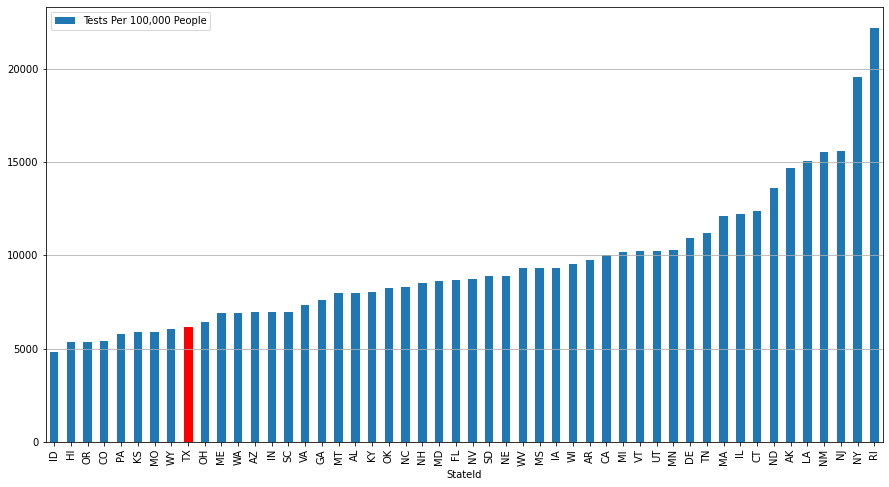

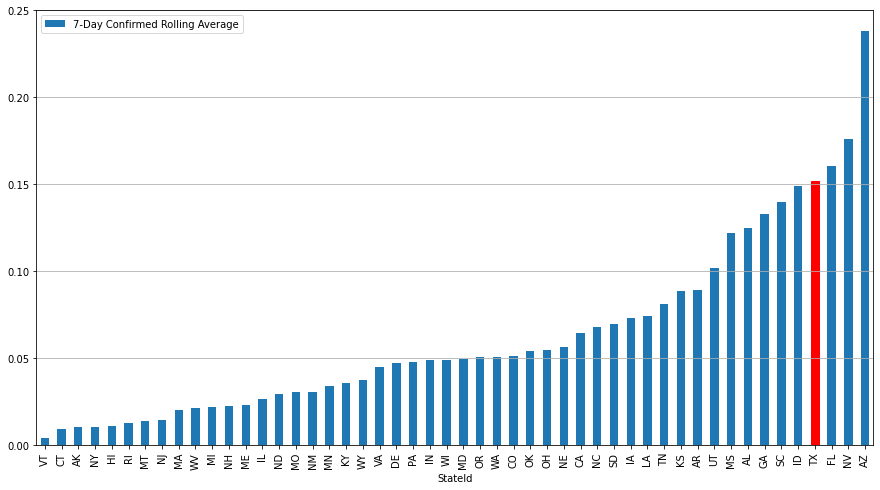

## 7-Day Rolling Averages of Confirmed Percentage for all US States & Territories

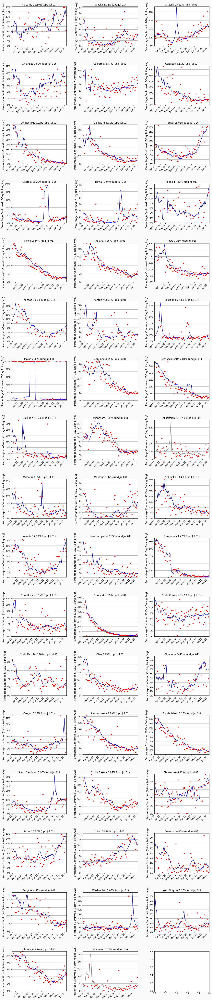

In [3]:
rollingrate = 7
states_to_drop = ['Puerto Rico', 'American Samoa', 'Guam', 'District of Columbia', 'Northern Mariana Islands', 'Virgin Islands']

series = get_timeseries(rollingrate, states_to_drop)

latestdata = get_latest_data();

printmd('# USA Data')

make_usa_choropleth(
    series=np.around(latestdata[field_rolling_average].astype(float) * 100, decimals=2), 
    locations=latestdata["StateId"], 
    title="Percent Positive in USA", 
    colorbartitle="% Pos", 
    colorspectrum=px.colors.sequential.YlOrRd
)

make_usa_choropleth(
    series=np.around(latestdata[field_test_availability].astype(float), decimals=2), 
    locations=latestdata["StateId"], 
    title="Test Availability in USA", 
    colorbartitle="Rate per 100,000 ppl", 
    colorspectrum=px.colors.sequential.Blues
)

plot_bar(latestdata, "StateId", field_test_availability, interested_state='TX')
plot_bar(latestdata, "StateId", field_rolling_average, interested_state='TX')

printmd('## 7-Day Rolling Averages of Confirmed Percentage for all US States & Territories')

states = np.sort(series.dropna(subset=[field_rolling_average])['Province_State'].unique())

output_multiple_states(states)
plt.show()

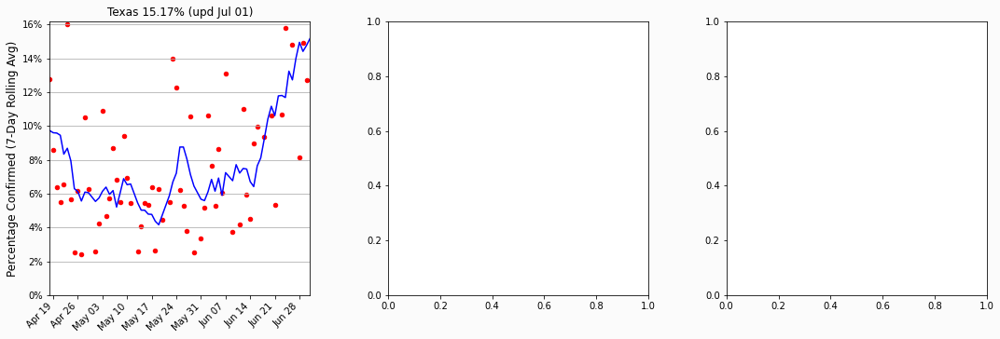

In [4]:
output_state_data(['Texas'])

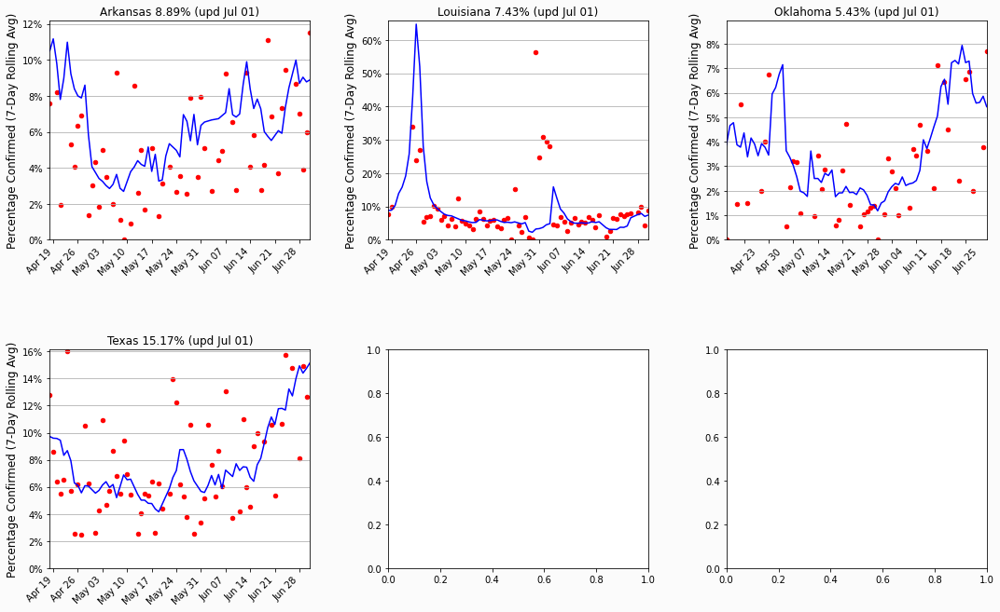

In [5]:
output_state_data(['Texas', 'Louisiana', 'Oklahoma', 'Arkansas'])

In [6]:
output_state_data(None)

In [203]:
url = get_gif_map()
Image(url=url)

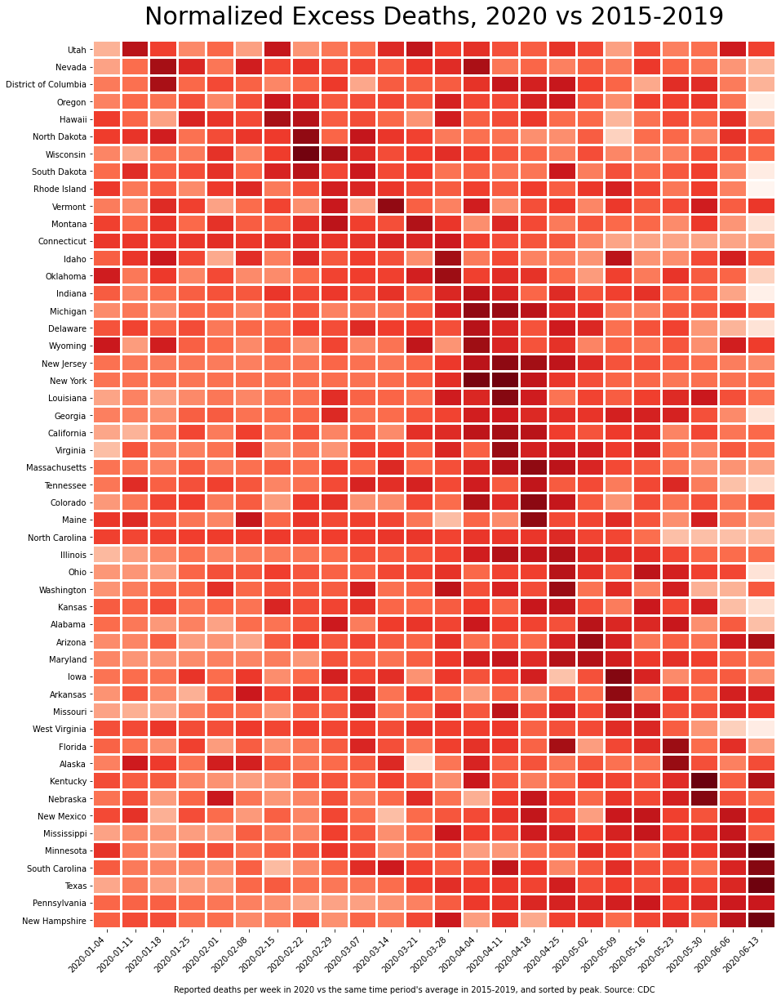

In [207]:
get_normalized_excess_deaths()

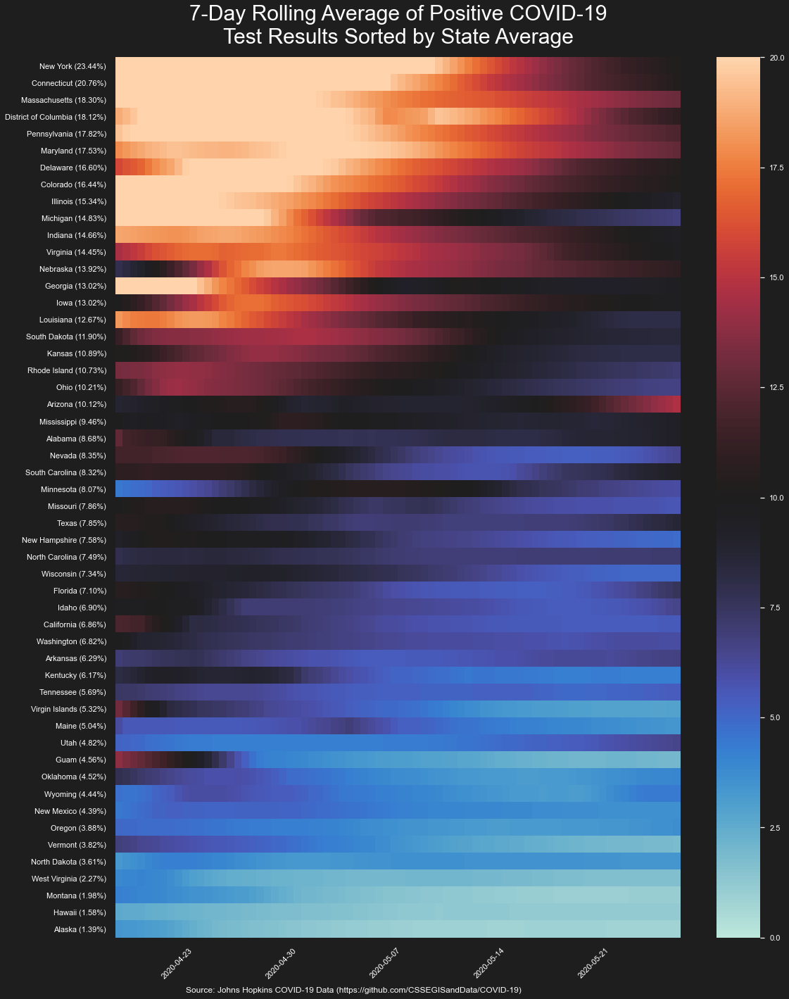

In [109]:
get_rolling_heatmap()

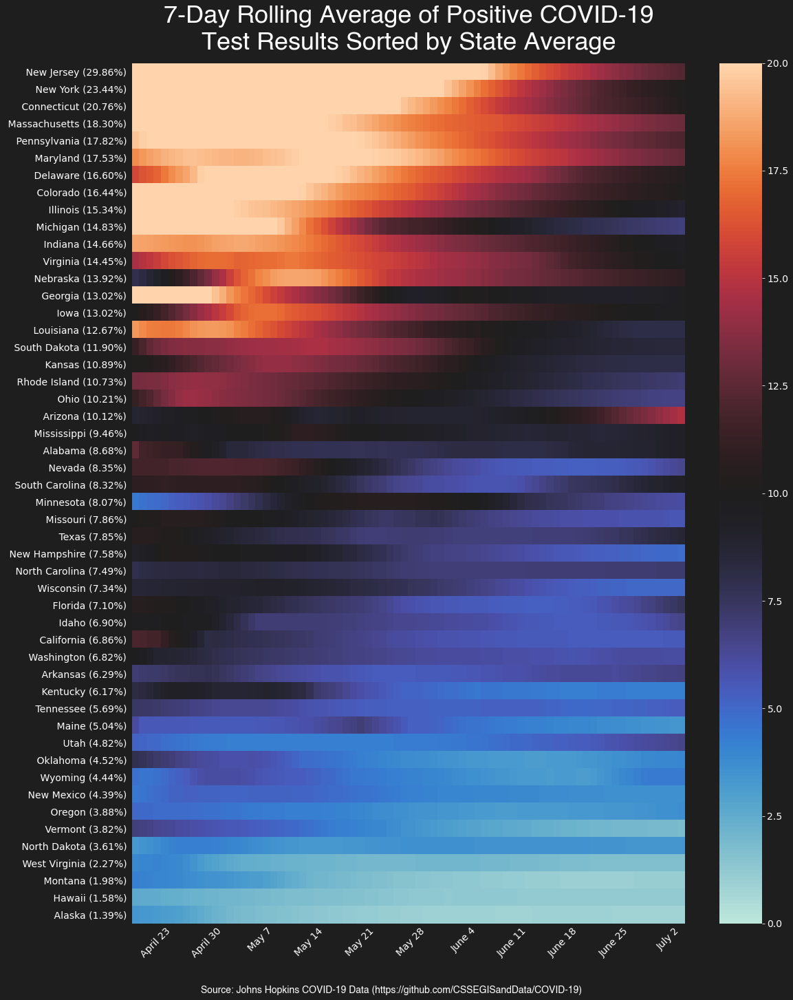

In [6]:
%config InlineBackend.print_figure_kwargs={'facecolor' : "#1f1e1e"}


xx = get_daily_report_data().sort_values(by=['Province_State', 'Date']).reset_index()
xx['People_Tested_2'] = xx.sort_values(by=['Date']).groupby(['Province_State'])['People_Tested'].cummax()
xx['New_Tests'] = xx.sort_values(by=['Province_State', 'Date']).groupby(['Province_State'])['People_Tested'].diff()
xx = xx[['Province_State', 'Date', 'Confirmed', 'People_Tested', 'New_Tests', 'People_Tested_2']]
xx['Confirmed_Percent'] = xx['Confirmed'].div(xx['New_Tests']) * 100
pd.set_option('display.max_rows', 500)
xx['ConfirmedPercent'] = xx['Confirmed'].div(xx['People_Tested'])
xx = xx[~xx['Province_State'].isin(states_to_drop)]
xx = xx.set_index(['Province_State', 'Date'])
xx['ConfirmedPercentRolling'] = xx.sort_values(by=['Province_State', 'Date']).groupby('Province_State')['ConfirmedPercent'].rolling(window=7).mean().reset_index(level=1, drop=1)

xx = xx.dropna()
xxp = xx.reset_index()[['Province_State', 'Date', 'ConfirmedPercentRolling']].pivot(values='ConfirmedPercentRolling', index='Date', columns='Province_State')
xxp = xxp.reindex(xxp.mean().sort_values(ascending=False).index, axis=1)

#sns.set(font_scale=1.1)
plt.style.use('dark_background')
plt.rc('figure.constrained_layout', use=False)
#sns.set(font='sans-serif')
#plt.subplots_adjust(left=1, right=1.1, top=0.9, bottom=0.1)
plt.subplots(figsize=(18,23))

ax = sns.heatmap(xxp.transpose() * 100, vmin=0, vmax=20, cmap='icefire')

x_dates = [list(reversed(pd.Series(xxp.index)))[i].strftime('%B %-d') if i % 7==0 else '' for i in np.arange(len(xxp.index)-1,-1, -1)]

ylabels = [' {0} ({1:.2f}%) '.format(a[0], a[1]*100) for a in zip(xxp.columns, xxp.mean().sort_values(ascending=False))]
ax.set_xticklabels(labels=x_dates, rotation=45, ha='right', size=14)
ax.set_yticklabels(labels=ylabels, size=14)
ax.set_ylabel('')
ax.set_xlabel('')
ax.tick_params(axis='both', which='both', length=0)

ax.collections[0].colorbar.ax.tick_params(labelsize=14)

ax.set_title('7-Day Rolling Average of Positive COVID-19\nTest Results Sorted by State Average', size=36, pad=20, fontname='Helvetica')

plt.annotate('Source: Johns Hopkins COVID-19 Data (https://github.com/CSSEGISandData/COVID-19)', (0,0), (100, -90), xycoords='axes fraction', fontname='Helvetica', textcoords='offset points', size=14, va='top')
plt.savefig("covid19-confirmed-heatmap.png")


['',
 '',
 '',
 '',
 '',
 'April 23',
 '',
 '',
 '',
 '',
 '',
 '',
 'April 30',
 '',
 '',
 '',
 '',
 '',
 '',
 'May 7',
 '',
 '',
 '',
 '',
 '',
 '',
 'May 14',
 '',
 '',
 '',
 '',
 '',
 '',
 'May 21',
 '',
 '',
 '',
 '',
 '',
 '',
 'May 28',
 '',
 '',
 '',
 '',
 '',
 '',
 'June 4',
 '',
 '',
 '',
 '',
 '',
 '',
 'June 11',
 '',
 '',
 '',
 '',
 '',
 '',
 'June 18',
 '',
 '',
 '',
 '',
 '',
 '',
 'June 25',
 '',
 '',
 '',
 '',
 '',
 '',
 'July 2']